<a href="https://colab.research.google.com/github/angiecoronel12/Sleep_Stage/blob/main/1_Analisis_exploratorio.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 1. **Análisis exploratorio de los datos**

La extracción de caracteristicas de la señal se realizó previamente en el entorno de MATLAB, por lo tanto el detalle de las mismas no hace parte de estos notebooks.

# 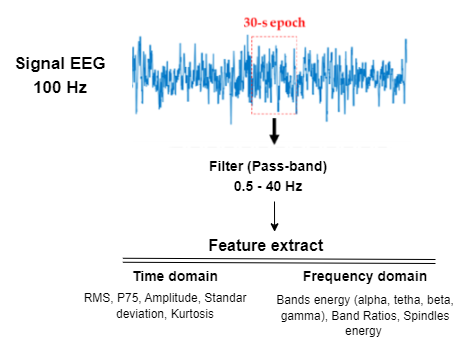

In [1]:
# Importe de librerias
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import os
import seaborn as sns

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
# Carga del archivo con los datos de las señales
folder_path = '/content/drive/My Drive/Deep_learning_proyecto/Signals_10_subjects'
files = os.listdir(folder_path)
print(files)

['caracteristicas_S14.csv', 'caracteristicas_S4.csv', 'caracteristicas_S12.csv', 'caracteristicas_S1.csv', 'caracteristicas_S6.csv', 'caracteristicas_S10.csv', 'caracteristicas_S11.csv', 'caracteristicas_S5.csv', 'caracteristicas_S9.csv', 'caracteristicas_S3.csv', 'caracteristicas_S15.csv', 'caracteristicas_S16.csv', 'caracteristicas_S8.csv', 'caracteristicas_S7.csv', 'caracteristicas_S2.csv', 'caracteristicas_S13.csv', 'caracteristicas_S19.csv', 'caracteristicas_S18.csv', 'caracteristicas_S20.csv', 'caracteristicas_S17.csv', 'data_process.h5', 'data_process_1.h5', 'reformatted_data.pkl', 'data.h5', 'data_process_2.h5']


In [4]:
# Lista para almacenar los DataFrames
data_frames = []

# Bucle para cargar cada archivo
for i in range(1, 21):  # 20 noches de registro
    file_name = f'caracteristicas_S{i}.csv'
    file_path = os.path.join(folder_path, file_name)

    # Comprobar si el archivo existe antes de intentar cargarlo
    if os.path.exists(file_path):
        df = pd.read_csv(file_path)
        data_frames.append(df)  # Agregar el DataFrame a la lista
    else:
        print(f'Archivo no encontrado: {file_name}')

data_frames[0].head()

,RMS_Signal,Median_Signal,Std_Signal,Skewness_Signal,Kurtosis_Signal,Amplitude,P75,E_SWA,E_Delta,Rel_delta,...,Ratio_alpha_beta,SEF95_Delta,SEF95_Theta,SEF95_Alpha,SEF95_Beta,SEF95_epoch,Splindes,Sawtooth_Waves,Mu_rhythm,Hipnograma
0,25.178022,-0.750183,2204.801200,0.323722,3.824483,282.631502,21.427106,4977.302857,5609.531040,0.508993,...,0.586462,2.871305,7.385498,12.534128,29.073924,4.640754,12.454934,816.671903,85.317814,W
1,11.674725,-0.234432,542.050135,1.189569,6.223080,178.262271,11.346520,680.395001,859.888213,0.205634,...,1.669052,3.211765,7.847032,11.852092,29.156371,9.404740,9.436833,225.488180,141.044992,W
2,9.799267,0.890842,256.789178,-0.388191,3.841920,113.652747,10.315018,1325.960595,1569.245071,0.466758,...,3.403128,3.026309,7.864497,11.013644,28.696302,8.625180,8.920034,337.108594,383.491276,W
3,8.767766,0.609524,229.704240,0.429741,6.359420,154.912821,8.580220,660.926654,775.002387,0.180237,...,2.118076,3.009504,7.794459,11.379046,28.939179,9.245034,11.804789,237.365886,311.375247,W
4,6.892308,0.328205,115.284366,0.112610,3.302956,79.238095,7.173626,282.953510,419.137454,0.391656,...,3.535280,3.332184,7.707600,11.294221,27.864908,20.940015,6.920234,220.804922,275.824667,W


In [5]:
print(f'Número de DataFrames en la lista: {len(data_frames)}')

Número de DataFrames en la lista: 20


## Estadistica descriptiva: Grafico pair-plot

In [6]:
data_s1 = data_frames[0]

In [ ]:
# Con los datos de un sujeto
sns.set(style="ticks", color_codes=True)

# Crear un pairplot
#pairplot = sns.pairplot(data_s1, hue=data_s1.columns[-1])
#plt.show()

## Hipnograma de todos los sujetos

Fases del sueño resumen:

* "W" -----> Wakefullness
* "R" -----> REM (Rapid Eye Movement)
* "1" -----> NREM 1 (No Rapid Eye Movement-transicion sleep)
* "2" -----> NREM 2 (No Rapid Eye Movement-Light sleep)
* "3" -----> NREM 3 (No Rapid Eye Movement-Deep sleep)

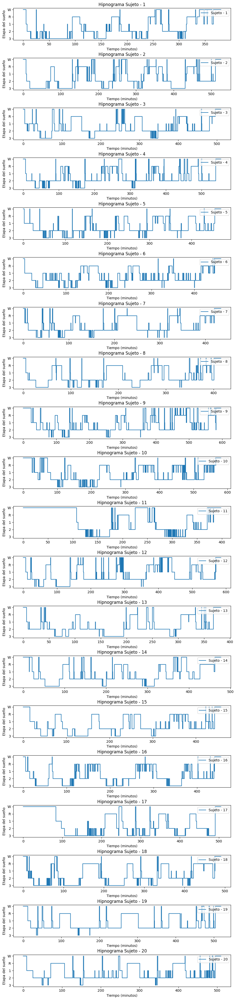

In [ ]:
# Configuración inicial
num_subjects = len(data_frames)  # Número de sujetos o DataFrames
fig, axes = plt.subplots(nrows=num_subjects, ncols=1, figsize=(10, 2 * num_subjects))  # Ajusta el tamaño como sea necesario
fig.tight_layout(pad=3.0)  # Ajusta el espaciamiento entre gráficos

# Mapeo de las etapas de sueño
stage_mapping = {'3': 0, '2': -1, '1': -2, 'R': -3, 'W': -4}

# Graficar cada hipnograma
for i, df in enumerate(data_frames):
    # Obtener los datos de la última columna y mapearlos
    hipnogram_data = df.iloc[:, -1].map(stage_mapping)
    time_vector = pd.Series(range(len(hipnogram_data))) * 30 / 60  # Tiempo en minutos

    # Configurar el subplot correspondiente
    ax = axes[i] if num_subjects > 1 else axes  # Ajustar para el caso de un solo subplot
    ax.plot(time_vector, hipnogram_data, drawstyle='steps-post', label=f'Sujeto - {i + 1}')
    ax.set_yticks(list(stage_mapping.values()))
    ax.set_yticklabels(list(stage_mapping.keys()))
    ax.invert_yaxis()  # Invertir eje Y
    ax.set_title(f'Hipnograma Sujeto - {i + 1}')
    ax.set_xlabel('Tiempo (minutos)')
    ax.set_ylabel('Etapa del sueño')
    ax.legend(loc='upper right')

# Mostrar el gráfico completo
plt.show()

In [ ]:
# ruta del archivo HDF5
hdf5_file_path = '/content/drive/My Drive/Deep_learning_proyecto/Signals_10_subjects/data.h5'

with pd.HDFStore(hdf5_file_path) as store:
    for i, df in enumerate(data_frames):
        store.put(f'df{i+1}', df, format='table')

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

## Grafica las 33 caracteristicas en el tiempo (1 sujeto)

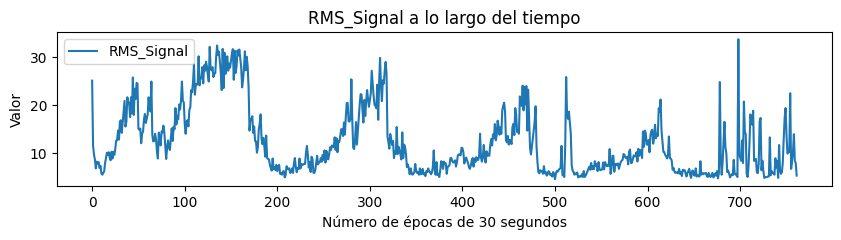

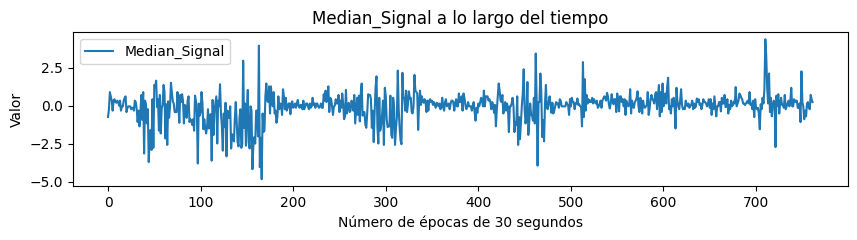

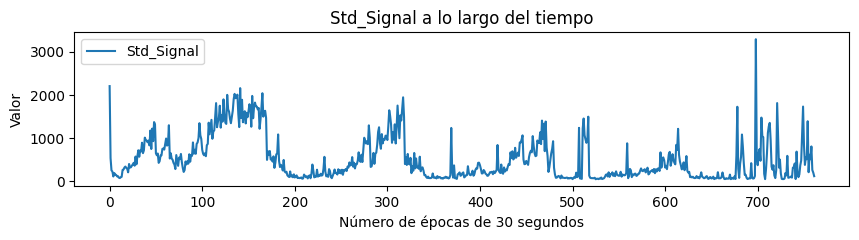

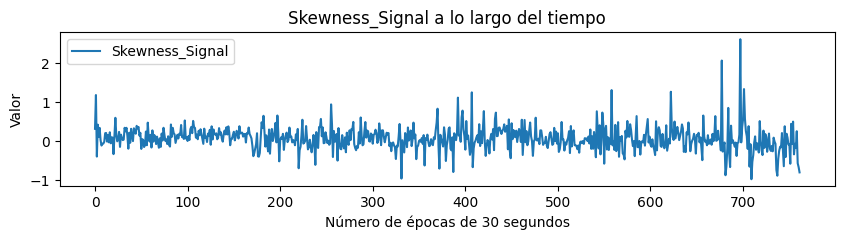

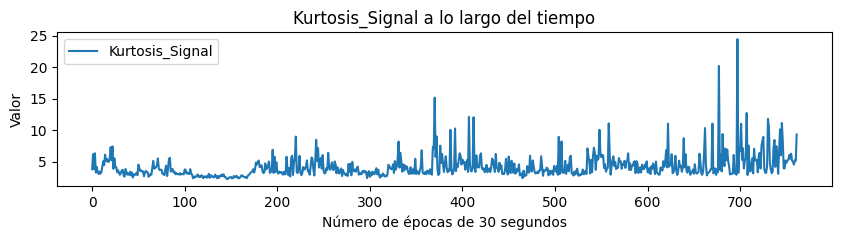

...

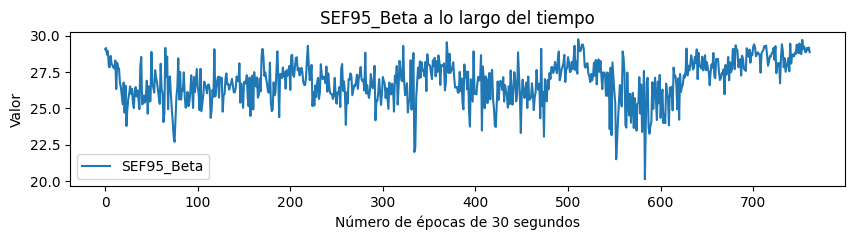

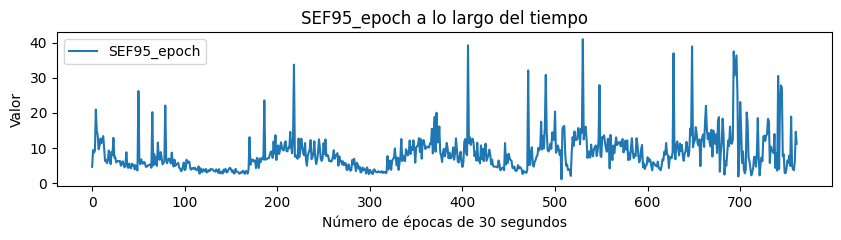

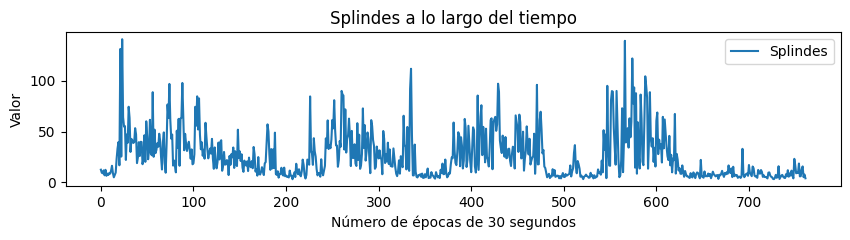

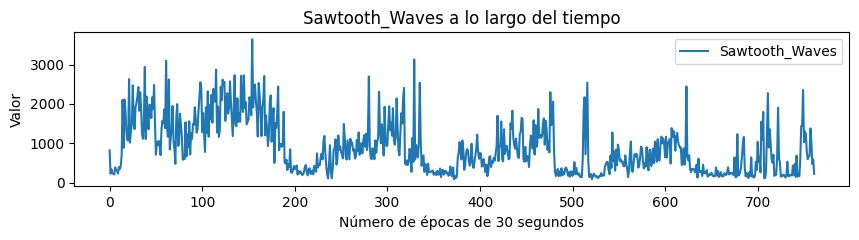

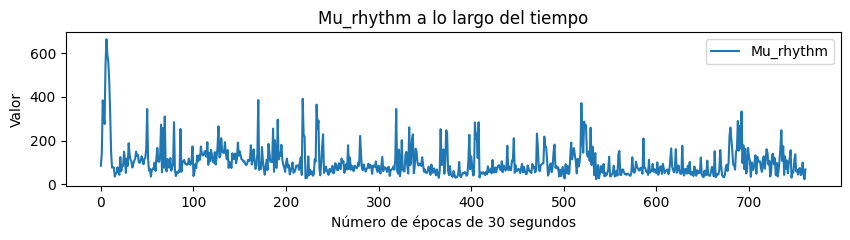

In [ ]:
# Crear una variable de tiempo basada en el número de épocas
tiempo = range(len(data_s1))

# Graficar cada columna en el tiempo
for columna in data_s1.columns[:-1]:
    plt.figure(figsize=(10, 2))
    plt.plot(tiempo, data_s1[columna], label=columna)
    plt.title(columna + " a lo largo del tiempo")
    plt.xlabel("Número de épocas de 30 segundos")
    plt.ylabel("Valor")
    plt.legend()
    plt.show()